# Customer Segmentation and personality analysis

#Introduction

Customer personality analysis is a crucial tool that businesses can use to gain a deeper understanding of their target customers. By analyzing customer data, businesses can identify customer segments and their unique preferences, motivations, and behaviors. This information can then be used to modify products and services to better suit the needs of each customer segment.

For instance, instead of launching a product and marketing it to all customers in the company's database, businesses can use customer personality analysis to identify which customer segment is most likely to buy the product. They can then tailor their marketing strategies to target that specific segment, resulting in higher conversion rates and a better return on investment.

# Overview

Customer personality analysis involves gathering data on factors such as demographics, psychographics, and past behavior. This data is then analyzed to identify patterns and insights that can help businesses make informed decisions about product development, marketing, and customer engagement. By understanding their customers at a deeper level, businesses can build stronger relationships, increase customer satisfaction, and ultimately drive growth.

#About the Dataset

The analysis is based on a dataset called "Customer Personality Analysis" (https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis?datasetId=1546318&sortBy=voteCount) which was sourced from Kaggle and contributed by Dr. Omar Romero-Hernandez . The dataset contains a variety of attributes that help to analyze the factors to segemnt customers. This dataset has 2,240 rows of observations and 28 columns of variables. Among the
variables, there are 5-character variables and 23 numerical variables.

#Columns

People

ID: Customer's unique identifier
Year_Birth: Customer's birth year
Education: Customer's education level
Marital_Status: Customer's marital status
Income: Customer's yearly household income
Kidhome: Number of children in customer's household
Teenhome: Number of teenagers in customer's household
Dt_Customer: Date of customer's enrollment with the company
Recency: Number of days since customer's last purchase
Complain: 1 if the customer complained in the last 2 years, 0 otherwise

Products

MntWines: Amount spent on wine in last 2 years
MntFruits: Amount spent on fruits in last 2 years
MntMeatProducts: Amount spent on meat in last 2 years
MntFishProducts: Amount spent on fish in last 2 years
MntSweetProducts: Amount spent on sweets in last 2 years
MntGoldProds: Amount spent on gold in last 2 years

Promotion

NumDealsPurchases: Number of purchases made with a discount
AcceptedCmp1: 1 if customer accepted the offer in the 1st campaign, 0 otherwise
AcceptedCmp2: 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
AcceptedCmp3: 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
AcceptedCmp4: 1 if customer accepted the offer in the 4th campaign, 0 otherwise
AcceptedCmp5: 1 if customer accepted the offer in the 5th campaign, 0 otherwise
Response: 1 if customer accepted the offer in the last campaign, 0 otherwise

Place

NumWebPurchases: Number of purchases made through the company’s website
NumCatalogPurchases: Number of purchases made using a catalogue
NumStorePurchases: Number of purchases made directly in stores
NumWebVisitsMonth: Number of visits to company’s website in the last month

# Problem statement and Objective

Our objective is to create a machine learning model that has the ability to categorize customers. To achieve this, we will be working with a dataset that has been collected from a marketing campaign. The goal of the model is to predict the response of various customer segments to a specific product or service.

# Solution and Analysis

# Prepare the tools

Import the required tools

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from IPython.display import Markdown
import joblib
import missingno as msno
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
palette = sns.color_palette(['gold','#cc0000', '#ace600','#33cccc'])
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler # For handling categorical column and scaling numeric columns
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier
import joblib

Setup plotly

This function is required for plotly to run properly in colab without it sometimes the plots don't render properly.

To avoid code repeatability, enable plotly in cell function is created

In [2]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

# Load the data

Read dataset from csv file

In [3]:
dataset =  pd.read_csv("marketing_campaign.csv")

# Understanding the data

Descriptive Analysis

In [4]:
dataset.shape

(2240, 29)

In [5]:
print(f'We see the dataset has {dataset.shape[0]} observations and {dataset.shape[1]} features.')

We see the dataset has 2240 observations and 29 features.


Review the data and sample data

In [6]:
dataset.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


In [7]:
dataset.sample(10)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
1519,3887,1970,Graduation,Single,27242.0,1,0,11-11-2012,2,3,...,9,0,0,0,0,0,0,3,11,1
1197,6606,1969,Master,Married,70091.0,1,0,31-03-2013,11,964,...,8,0,1,0,0,0,0,3,11,0
1491,7494,1950,PhD,Divorced,42873.0,1,1,21-01-2013,11,209,...,8,0,0,0,0,0,0,3,11,0
537,6931,1967,Graduation,Divorced,76982.0,0,0,15-02-2014,19,464,...,4,0,0,1,0,0,0,3,11,1
481,5154,1972,Master,Divorced,37760.0,1,0,11-08-2013,54,26,...,6,0,0,0,0,0,0,3,11,0
1295,3551,1954,Master,Together,60033.0,0,1,29-03-2014,28,62,...,2,0,0,0,0,0,0,3,11,0
591,7627,1975,Master,Married,92163.0,0,0,12-12-2012,25,817,...,2,0,0,1,1,0,0,3,11,1
1538,1079,1971,PhD,Married,71969.0,0,1,16-10-2012,59,1000,...,8,0,1,0,0,0,0,3,11,0
799,8523,1968,Graduation,Married,19329.0,1,0,14-12-2013,39,24,...,8,0,0,0,0,0,0,3,11,0
383,3310,1973,2n Cycle,Married,35688.0,2,1,22-08-2012,94,73,...,8,0,0,0,0,0,0,3,11,0


#Check datatype and information regarding all different features

We want to look at the datatypes and check to see if they were interpreted correctly.

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

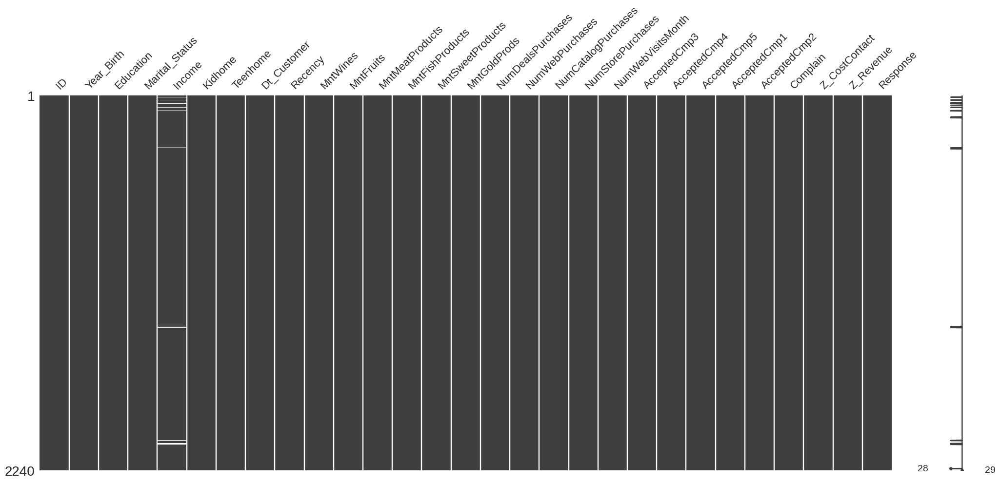

In [9]:
msno.matrix(dataset);

Observations

1.   There are missing values in income
2.   There are some features in the dataset which are of categorical type
3. DT_customer indicates the date when a customer joined however it's not parsed as Date time


Learning the data mathematically

In [10]:
dataset.describe(include = 'all')

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
count,2240.000000,2240.000000,2240,2240,2216.000000,2240.000000,2240.000000,2240,2240.000000,2240.000000,...,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.0,2240.0,2240.000000
unique,NaN,NaN,5,8,NaN,NaN,NaN,663,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Graduation,Married,NaN,NaN,NaN,31-08-2012,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,1127,864,NaN,NaN,NaN,12,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,5592.159821,1968.805804,NaN,NaN,52247.251354,0.444196,0.506250,NaN,49.109375,303.935714,...,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,3.0,11.0,0.149107
std,3246.662198,11.984069,NaN,NaN,25173.076661,0.538398,0.544538,NaN,28.962453,336.597393,...,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.0,0.0,0.356274
min,0.000000,1893.000000,NaN,NaN,1730.000000,0.000000,0.000000,NaN,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
25%,2828.250000,1959.000000,NaN,NaN,35303.000000,0.000000,0.000000,NaN,24.000000,23.750000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
50%,5458.500000,1970.000000,NaN,NaN,51381.500000,0.000000,0.000000,NaN,49.000000,173.500000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000
75%,8427.750000,1977.000000,NaN,NaN,68522.000000,1.000000,1.000000,NaN,74.000000,504.250000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,11.0,0.000000


# Data Pre-processing

Look for missing values

Even though we have identified missing values for income. Let's check to review to if there are any other missing values which need to be handled

In [11]:
dataset.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

We can confirm there are 24 missing values for income feature. There are no missing values for any other feature. We will be handling the missing values for income in an upcoming step

Check for duplicated records

In [12]:
print(f'There are {dataset.duplicated().sum()} duplicated rows in the dataset.')

There are 0 duplicated rows in the dataset.


Rename columns of dataset

This is done to make it easier to process the data. At the same time, it helps with the understanding and analysis of the data

In [13]:
dataset.rename(columns = {'MntGoldProds':'MntGoldProducts'}, inplace = True)

Handling the missing values for Income feature

In [14]:
data = dataset.dropna(axis=0)
data.isnull().sum()

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProducts        0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64

Check skewness before imputation

In [15]:
data['Income'].skew()

6.7634873728111184

If the skewness is between -0.5 and 0.5, the data are fairly symmetrical. If the skewness is between -1 and – 0.5 or between 0.5 and 1, the data are moderately skewed. If the skewness is less than -1 or greater than 1, the data are highly skewed.

Replacing null values with median cause the data is skewed which means there are outliers in the data

In [16]:
data['Income'].fillna(data['Income'].median(), inplace = True)

<ipython-input-16-fa17dfd754d2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Income'].fillna(data['Income'].median(), inplace = True)


Correcting the datatype

Converting columns to datetime format


In [17]:
data['Dt_Customer'] = pd.to_datetime(dataset['Dt_Customer'])

<ipython-input-17-d25be214e6e9>:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  data['Dt_Customer'] = pd.to_datetime(dataset['Dt_Customer'])
<ipython-input-17-d25be214e6e9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Dt_Customer'] = pd.to_datetime(dataset['Dt_Customer'])


In [18]:
data['Year_Birth'] = pd.to_datetime(dataset['Year_Birth'], format ='%Y')

<ipython-input-18-8d7b170181ac>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Year_Birth'] = pd.to_datetime(dataset['Year_Birth'], format ='%Y')


Feature engineering

Examine unique values for various categories

In [19]:
data['Education'].value_counts()

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64

In [20]:
data['Marital_Status'].value_counts()

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

In [21]:
print("The newest customer's enrolment date in the records:", max(dataset['Dt_Customer']))
print("The oldest customer's enrolment date in the records:", min(dataset['Dt_Customer']))

The newest customer's enrolment date in the records: 31-12-2013
The oldest customer's enrolment date in the records: 01-01-2013


We only have data of three years (2012 to 2014)

Create feature from Dt_Customer that indicates the number of days a customer is registered in the firm's database.
To keep it simple, I am taking this value relative to the most recent customer in the record.

In [22]:
data['Date_Collected'] = '01-01-2015'
data['Date_Collected'] = pd.to_datetime(data.Date_Collected)
data['Time_Enrolled_Days'] = (data['Date_Collected'] - data['Dt_Customer']).dt.days

<ipython-input-22-fdcc6b73b1d4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Date_Collected'] = '01-01-2015'
<ipython-input-22-fdcc6b73b1d4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Date_Collected'] = pd.to_datetime(data.Date_Collected)
<ipython-input-22-fdcc6b73b1d4>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pan

Create feature to extract "Age" of a customer by the "Year_Birth"

In [23]:
data['Age'] = (data["Dt_Customer"].dt.year.max()) - (data['Year_Birth'].dt.year)

<ipython-input-23-c0c868c06e30>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Age'] = (data["Dt_Customer"].dt.year.max()) - (data['Year_Birth'].dt.year)


Create feature to calculate amount of years the person has been a customer

In [24]:
data['Years_Customer'] = (data["Dt_Customer"].dt.year.max()) - (data['Dt_Customer'].dt.year)

<ipython-input-24-876191f4b350>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Years_Customer'] = (data["Dt_Customer"].dt.year.max()) - (data['Dt_Customer'].dt.year)


In [25]:
data['Month_Customer'] = 12.0 * (2015 - data["Dt_Customer"].dt.year ) + (1 - data["Dt_Customer"].dt.month)

<ipython-input-25-6c004f147339>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Month_Customer'] = 12.0 * (2015 - data["Dt_Customer"].dt.year ) + (1 - data["Dt_Customer"].dt.month)


In [26]:
data['Days_Customer'] = (data["Dt_Customer"].max()) - (data['Dt_Customer'])

<ipython-input-26-4c368547b7e3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Days_Customer'] = (data["Dt_Customer"].max()) - (data['Dt_Customer'])


Create feature Total money spent to indicate the total amount spent by the customer in various categories.

In [27]:
data['TotalMoneySpent'] = data['MntWines']+data['MntFruits']+data['MntMeatProducts']+data['MntFishProducts']+data['MntSweetProducts']+data['MntGoldProducts']

<ipython-input-27-02bb39f1e6ad>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['TotalMoneySpent'] = data['MntWines']+data['MntFruits']+data['MntMeatProducts']+data['MntFishProducts']+data['MntSweetProducts']+data['MntGoldProducts']


Create feature for Total number of purchases made to indicate the total number of purchases made by the customer in various categories.

In [28]:
data['TotalNumOfPurchases'] = data['NumWebPurchases'] + data['NumCatalogPurchases'] + data['NumStorePurchases'] + data['NumDealsPurchases']

<ipython-input-28-a5da39dc0871>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['TotalNumOfPurchases'] = data['NumWebPurchases'] + data['NumCatalogPurchases'] + data['NumStorePurchases'] + data['NumDealsPurchases']


Create feature for Total number of accepted campagins to indicate the total accpeted campaigns by the customer in various categories.

In [29]:
data['TotalAccCmp'] = data['AcceptedCmp1'] + data['AcceptedCmp2'] + data['AcceptedCmp3'] + data['AcceptedCmp4'] + data['AcceptedCmp5'] + data['Response']

<ipython-input-29-9a83231f3a49>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['TotalAccCmp'] = data['AcceptedCmp1'] + data['AcceptedCmp2'] + data['AcceptedCmp3'] + data['AcceptedCmp4'] + data['AcceptedCmp5'] + data['Response']


Deriving living situation by marital status

In [30]:
data["Partner"]=data["Marital_Status"].replace({"Married":"Yes", "Together":"Yes", "Absurd":"No", "Widow":"No", "YOLO":"No", "Divorced":"No", "Single":"No","Alone":"No"})

<ipython-input-30-48dbf32217d9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Partner"]=data["Marital_Status"].replace({"Married":"Yes", "Together":"Yes", "Absurd":"No", "Widow":"No", "YOLO":"No", "Divorced":"No", "Single":"No","Alone":"No"})


Segmenting education levels in three groups

In [31]:
data["Education"]=data["Education"].replace({"Basic":"Undergraduate","2n Cycle":"Undergraduate", "Graduation":"Graduate", "Master":"Postgraduate", "PhD":"Postgraduate"})

<ipython-input-31-b03ad7be7d4b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Education"]=data["Education"].replace({"Basic":"Undergraduate","2n Cycle":"Undergraduate", "Graduation":"Graduate", "Master":"Postgraduate", "PhD":"Postgraduate"})


Create feature for Total children living in the house

In [32]:
data["Children"] = data["Kidhome"] +  data["Teenhome"]

<ipython-input-32-d7ffaf6e7085>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Children"] = data["Kidhome"] +  data["Teenhome"]


To get further clarity of household, Creating feature indicating Family Size

In [33]:
data['Family_Size'] = data['Partner'].replace({'No': 1, 'Yes':2}) + data['Children']

<ipython-input-33-a2076210534b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Family_Size'] = data['Partner'].replace({'No': 1, 'Yes':2}) + data['Children']


Create a feature Is Parent to indicate parenthood status

In [34]:
data['Is_Parent'] = np.where(data.Children > 0, 1, 0)

<ipython-input-34-2f8420d3ee1c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Is_Parent'] = np.where(data.Children > 0, 1, 0)


Adding columns about the day, month and year cutomer joined

In [35]:
data['YearJoined'] = data['Dt_Customer'].dt.year
data['MonthJoined'] = data['Dt_Customer'].dt.strftime("%B")
data['DayJoined'] = data['Dt_Customer'].dt.day_name()

<ipython-input-35-924ff1fde918>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['YearJoined'] = data['Dt_Customer'].dt.year
<ipython-input-35-924ff1fde918>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['MonthJoined'] = data['Dt_Customer'].dt.strftime("%B")
<ipython-input-35-924ff1fde918>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pyda

Dividing age into groups

In [36]:
data['AgeGroup'] = pd.cut(x = data['Age'], bins = [1, 17, 24, 44, 64, 150],
                         labels = ['Under 18','Young adult','Adult','Middel Aged','Senior Citizen'])

<ipython-input-36-46b6bac01044>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['AgeGroup'] = pd.cut(x = data['Age'], bins = [1, 17, 24, 44, 64, 150],


Dropping columns which are not required

In [37]:
data.drop(['Z_CostContact','Z_Revenue','Year_Birth','Dt_Customer', 'Marital_Status'], axis=1, inplace=True)

<ipython-input-37-aa143117f976>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(['Z_CostContact','Z_Revenue','Year_Birth','Dt_Customer', 'Marital_Status'], axis=1, inplace=True)


In [38]:
data.head()

,ID,Education,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,TotalNumOfPurchases,TotalAccCmp,Partner,Children,Family_Size,Is_Parent,YearJoined,MonthJoined,DayJoined,AgeGroup
0,5524,Graduate,58138.0,0,0,58,635,88,546,172,...,25,1,No,0,1,0,2012,April,Monday,Middel Aged
1,2174,Graduate,46344.0,1,1,38,11,1,6,2,...,6,0,No,2,3,1,2014,August,Sunday,Middel Aged
2,4141,Graduate,71613.0,0,0,26,426,49,127,111,...,21,0,Yes,0,2,0,2013,August,Wednesday,Middel Aged
3,6182,Graduate,26646.0,1,0,26,11,4,20,10,...,8,0,Yes,1,3,1,2014,October,Thursday,Adult
4,5324,Postgraduate,58293.0,1,0,94,173,43,118,46,...,19,0,Yes,1,3,1,2014,January,Sunday,Adult


In [39]:
data.columns

Index(['ID', 'Education', 'Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProducts', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5',
       'AcceptedCmp1', 'AcceptedCmp2', 'Complain', 'Response',
       'Date_Collected', 'Time_Enrolled_Days', 'Age', 'Years_Customer',
       'Month_Customer', 'Days_Customer', 'TotalMoneySpent',
       'TotalNumOfPurchases', 'TotalAccCmp', 'Partner', 'Children',
       'Family_Size', 'Is_Parent', 'YearJoined', 'MonthJoined', 'DayJoined',
       'AgeGroup'],
      dtype='object')

In [40]:
data.shape

(2216, 41)

In [41]:
data['Days_Customer'] = data['Days_Customer'].dt.days.astype('int16')

<ipython-input-41-2427dbb4b435>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Days_Customer'] = data['Days_Customer'].dt.days.astype('int16')


In [42]:
data['Days_Customer']

0       971
1       125
2       472
3        65
4       321
       ... 
2235    541
2236     61
2237    315
2238    316
2239    782
Name: Days_Customer, Length: 2216, dtype: int16

# Exploratory Data Analysis

Examining Unique Values

In [43]:
unique_number = []
for i in data.columns:
    x = data[i].value_counts().count()
    unique_number.append(x)

pd.DataFrame(unique_number, index = data.columns, columns = ["Total Unique Values"])

,Total Unique Values
ID,2216
Education,3
Income,1974
Kidhome,3
Teenhome,3
Recency,100
MntWines,776
MntFruits,158
MntMeatProducts,554
MntFishProducts,182


In [44]:
data.describe(include=object).T

,count,unique,top,freq
Education,2216,3,Graduate,1116
Partner,2216,2,Yes,1430
MonthJoined,2216,12,August,210
DayJoined,2216,7,Sunday,342


Martial Status

In [45]:
enable_plotly_in_cell()

maritalstatus = data['Partner'].value_counts()

fig = px.pie(maritalstatus,
             values = maritalstatus.values,
             names = maritalstatus.index,
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label',
                  marker = dict(line = dict(color = 'white', width = 4)))
fig.show()

Observation

1. Majority of the customers have partners.
2. Only 1/3rd are singles

Spending by Marital Status

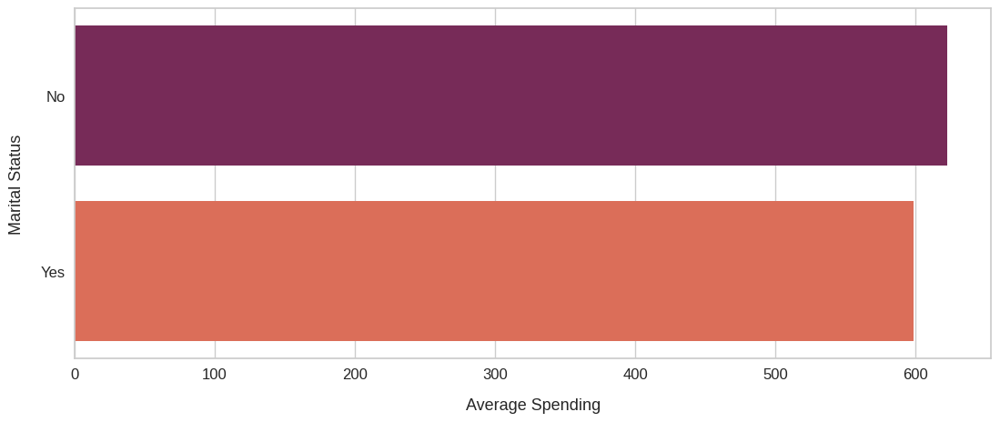

In [46]:
enable_plotly_in_cell()
maritalspending = data.groupby('Partner')['TotalMoneySpent'].mean().sort_values(ascending=False)
maritalspending_df = pd.DataFrame(list(maritalspending.items()), columns=['Marital Status', 'Average Spending'])

plt.figure(figsize=(13,5))
sns.barplot(data = maritalspending_df, x="Average Spending", y="Marital Status", palette='rocket');

plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('Average Spending', fontsize=13, labelpad=13)
plt.ylabel('Marital Status', fontsize=13, labelpad=13);

Observation

1. Even though the number of customers who have a partner is considerably higher. THe singles spent more money on the average compared to them

Child Analysis

In [47]:
enable_plotly_in_cell()
children = data['Children'].value_counts()

fig = px.pie(children,
             values = children.values,
             names = children.index,
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label',
                  marker = dict(line = dict(color = 'white', width = 2)))
fig.show()

Observation

1. 50% of the customers have 1 child
2. 28% don't have a child and 19% have 2 children

Average Child Wise Spendings

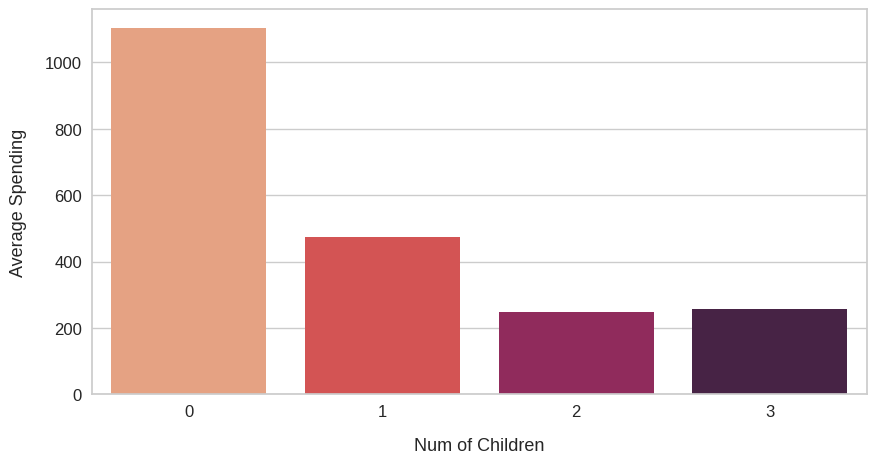

In [48]:
enable_plotly_in_cell()
childrenspending = data.groupby('Children')['TotalMoneySpent'].mean().sort_values(ascending=False)
childrenspending_df = pd.DataFrame(list(childrenspending.items()), columns=['Num of Children', 'Average Spending'])

plt.figure(figsize=(10,5))

sns.barplot(data=childrenspending_df,  x="Num of Children", y="Average Spending", palette='rocket_r');
plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('Num of Children', fontsize=13, labelpad=13)
plt.ylabel('Average Spending', fontsize=13, labelpad=13);

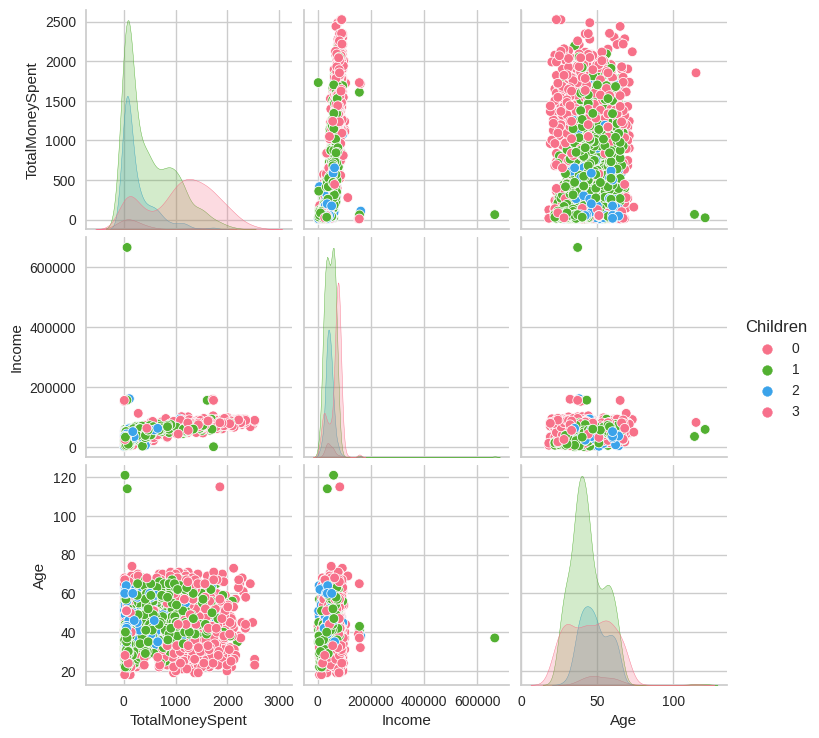

In [49]:
sns.pairplot(data , vars=['TotalMoneySpent','Income','Age'] , hue='Children', palette='husl');

Observation

1. Customers who don't have any children at home spent higher than the customers having 1 children.
The customers having 1 children are spending higher than the customers havin 2 and 3 children.

Income distribution

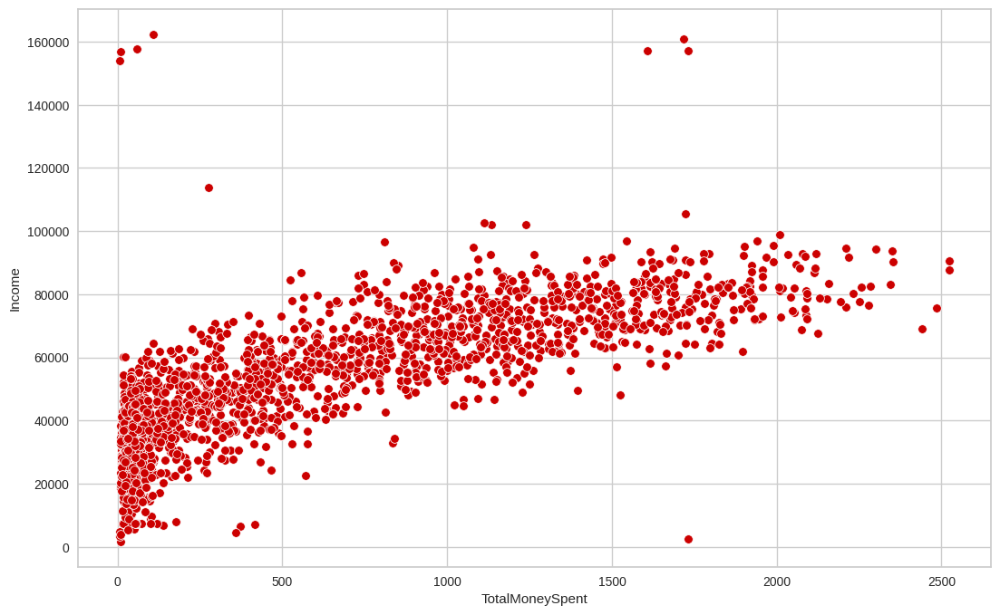

In [50]:
plt.figure(figsize=(13,8))
sns.scatterplot(x=data[data['Income']<600000]['TotalMoneySpent'], y=data[data['Income']<600000]['Income'], color='#cc0000');

Observation

1. The salaries of the customers have normal distribution with most of the customers earning between 25000 and 85000.

Age Distribution

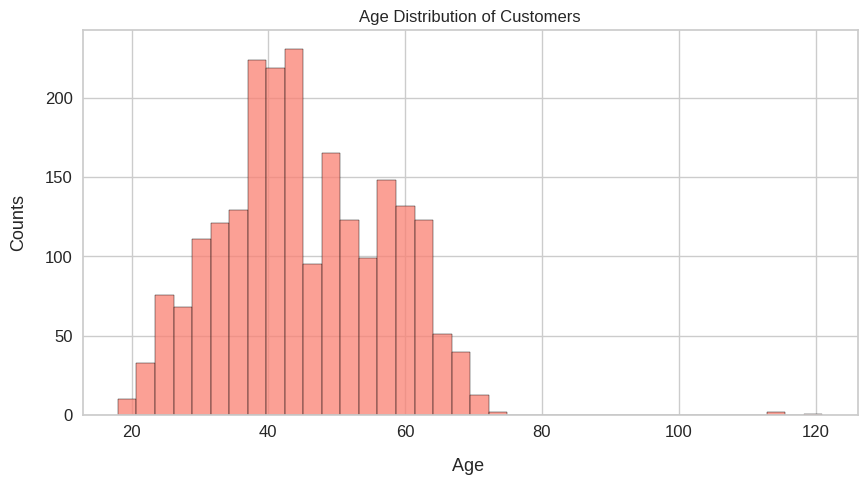

In [51]:
enable_plotly_in_cell()
plt.figure(figsize=(10,5))
ax = sns.histplot(data = data['Age'], color='salmon')
ax.set(title = "Age Distribution of Customers");
plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('Age ', fontsize=13, labelpad=13)
plt.ylabel('Counts', fontsize=13, labelpad=13);

Observation

1. Age of the customers is nearly normally distributed, with most of the customers aged between 40 and 60.

Age analysis with spending

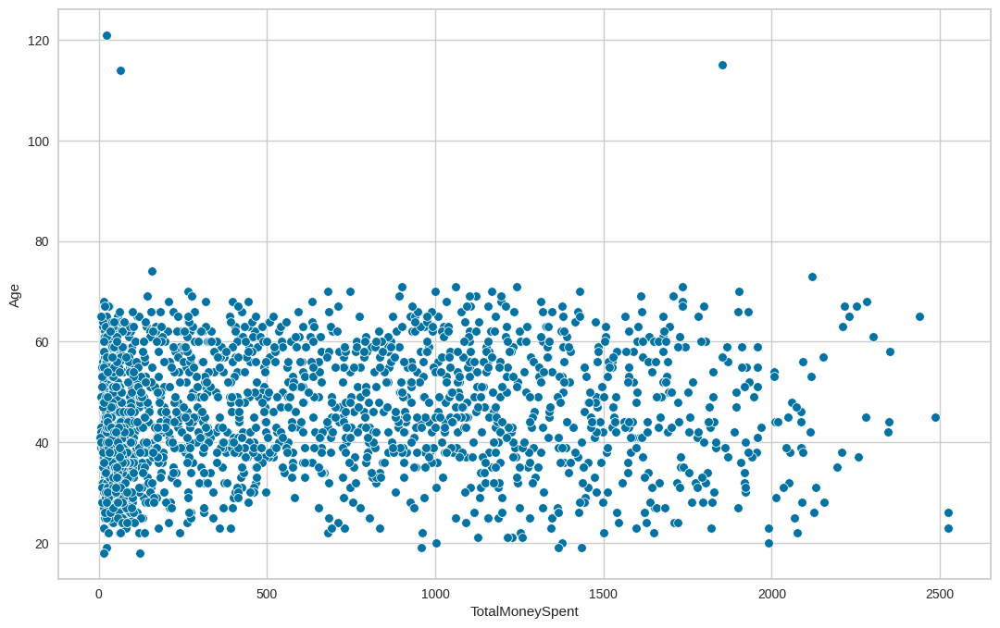

In [52]:
plt.figure(figsize=(13,8))
sns.scatterplot(x=data['TotalMoneySpent'], y=data['Age']);

Observation

1.There doesn't seem to be any clear relationship between age of customers and their spending habits.

Age group analysis

In [53]:
enable_plotly_in_cell()
agegroup = data['AgeGroup'].value_counts()

fig = px.pie(labels = agegroup.index, values = agegroup.values, names = agegroup.index, width = 550, height = 550)

fig.update_traces(textposition = 'inside',
                  textinfo = 'percent + label',
                  hole = 0.4,
                  marker = dict(colors = ["red", "green", "blue", "goldenrod", "magenta"],
                                line = dict(color = 'white', width = 2)))

fig.update_layout(annotations = [dict(text = 'Age Groups',
                                      x = 0.5, y = 0.5, font_size = 20, showarrow = False,
                                      font_color = 'black')],
                  showlegend = False)

fig.show()

/usr/local/lib/python3.10/dist-packages/plotly/express/_core.py:137: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



Observation

1. Almost 50% of the customers are adults
2. The second most popular category is middel aged

Age group analysis with spending

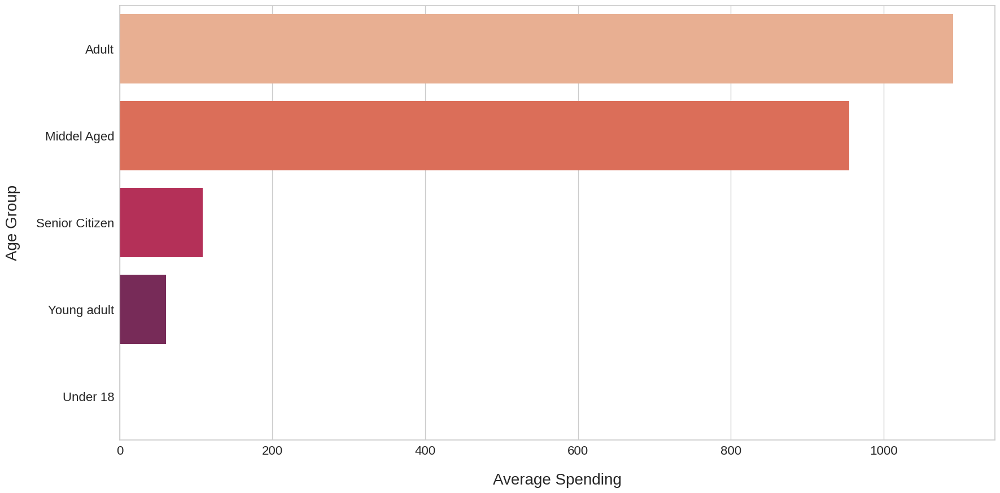

In [54]:
agegroupspending = data.groupby('AgeGroup')['TotalMoneySpent'].mean().sort_values(ascending=False)
agegroupspending_df = pd.DataFrame(list(agegroup.items()), columns=['Age Group', 'Average Spending'])

plt.figure(figsize=(20,10))

sns.barplot(data = agegroupspending_df, x="Average Spending", y='Age Group', palette='rocket_r');
plt.xticks( fontsize=16)
plt.yticks( fontsize=16)
plt.xlabel('Average Spending', fontsize=20, labelpad=20)
plt.ylabel('Age Group', fontsize=20, labelpad=20);

Observations

1. Adults spend more than other age groups

Education analysis

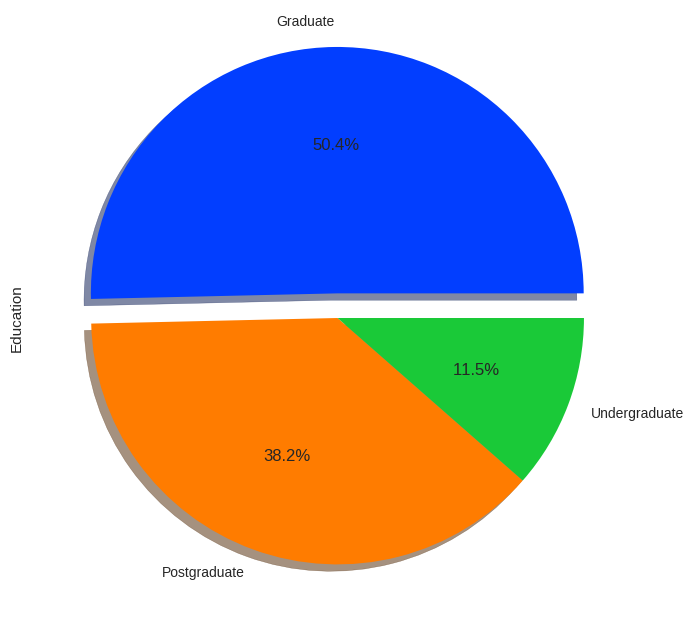

In [55]:
data['Education'].value_counts().plot.pie(explode=[0.1,0,0], autopct='%1.1f%%', shadow=True, figsize=(8,8), colors=sns.color_palette("bright"));

In [56]:
enable_plotly_in_cell()

fig = px.histogram(data, x = 'Education',
                   opacity = 1, barmode = 'overlay',
                   width = 800, height = 500,
                  color_discrete_sequence=px.colors.qualitative.G10)

fig.update_layout(title='Education Level')
fig.show()

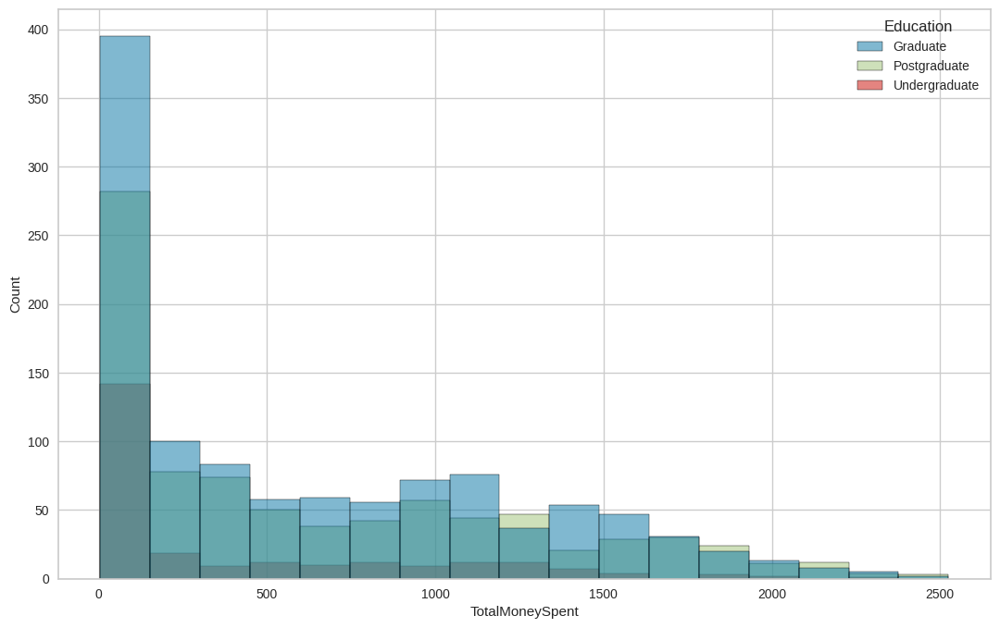

In [57]:
plt.figure(figsize=(13,8))
sns.histplot(x=data['TotalMoneySpent'], hue=data['Education']);

Observation

1.   50% of caustomers are graduates and only 11% of customers are undergraduates, remaining are postgraduates
2.   Majority are well educated



Most Bought Products

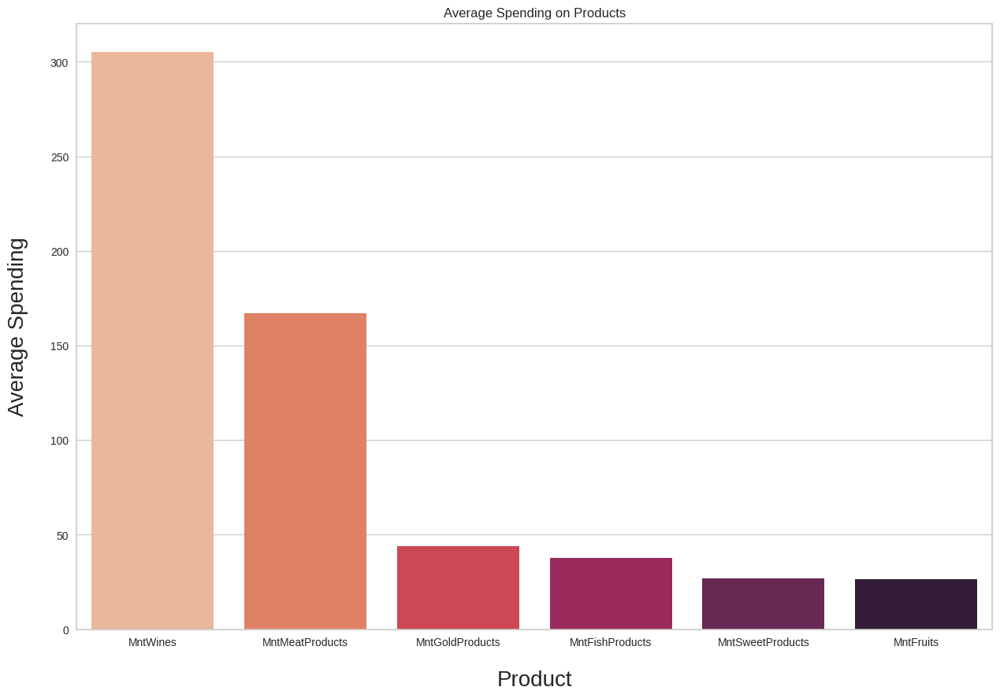

In [58]:
products = data[['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProducts']]
product_means = products.mean(axis=0).sort_values(ascending=False)
product_means_df = pd.DataFrame(list(product_means.items()), columns=['Product', 'Average Spending'])

plt.figure(figsize=(15,10))
plt.title('Average Spending on Products')
sns.barplot(data=product_means_df, x='Product', y='Average Spending', palette='rocket_r');
plt.xlabel('Product', fontsize=20, labelpad=20)
plt.ylabel('Average Spending', fontsize=20, labelpad=20);

Observation

1. Wine and Meats products are the most famous products among the customers.
2. Sweets and Fruits are not being purchased often.

# Outlier Detection

The presence of outliers in a classification or regression dataset can result in a poor fit and lower predictive modeling performance, therefore we should see there are ouliers in the data

<ipython-input-59-0e7ab541b29d>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




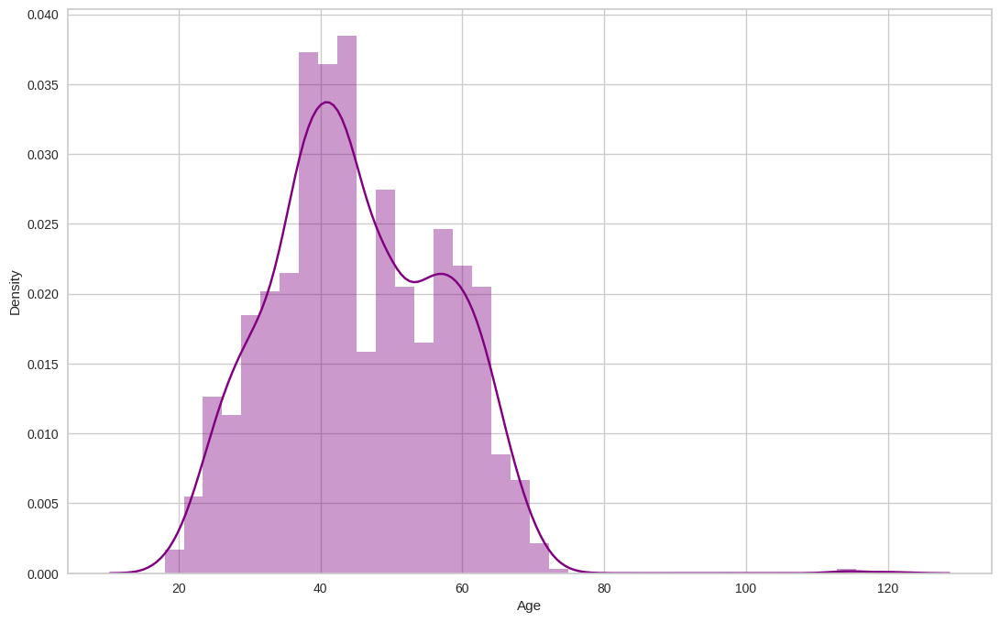

In [59]:
plt.figure(figsize=(13,8))
sns.distplot(data.Age, color='purple');

<ipython-input-60-16cfc341aea8>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




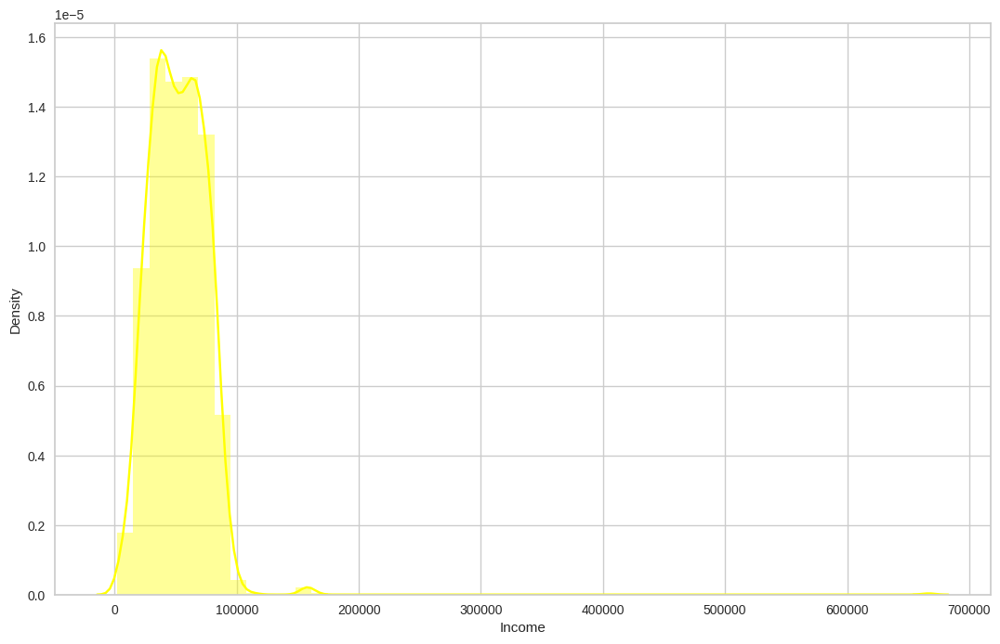

In [60]:
plt.figure(figsize=(13,8))
sns.distplot(data.Income, color='Yellow');

<ipython-input-61-20f604d0b302>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




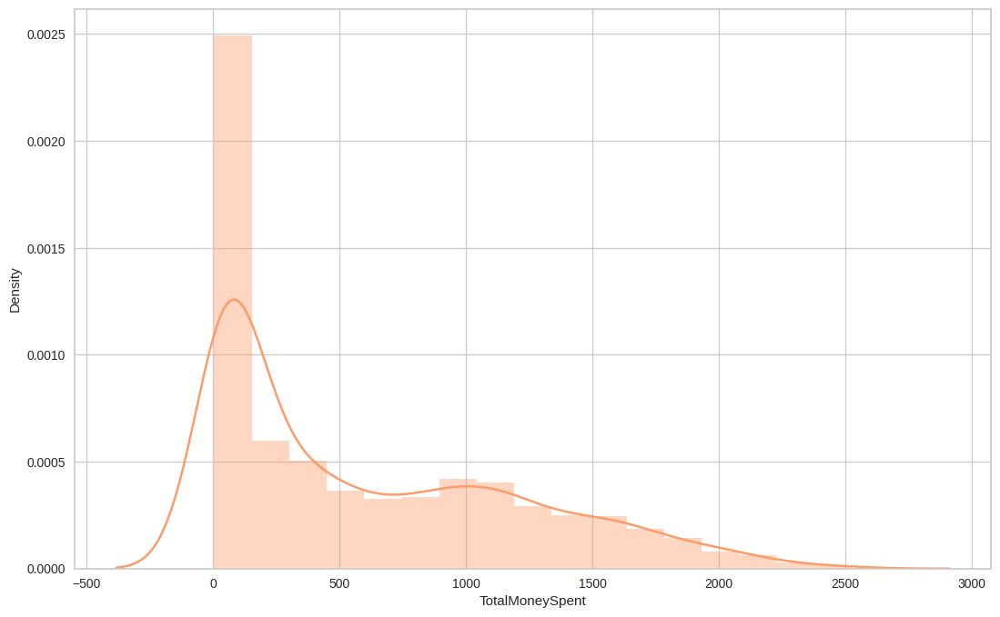

In [61]:
plt.figure(figsize=(13,8))
sns.distplot(data.TotalMoneySpent, color='#ff9966');

In [62]:
enable_plotly_in_cell()

fig = make_subplots(rows=1, cols=3)

fig.add_trace(go.Box(y=data['Age'], notched=True, name='Age', marker_color = '#6699ff',
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 2)

fig.add_trace(go.Box(y=data['Income'], notched=True, name='Income', marker_color = '#ff0066',
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 1)

fig.add_trace(go.Box(y=data['TotalMoneySpent'], notched=True, name='Money Spent', marker_color = 'lightseagreen',
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 3)

fig.update_layout(title_text='Box Plots for Numerical Variables')

fig.show()

In [63]:
data.head(1)

,ID,Education,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,TotalNumOfPurchases,TotalAccCmp,Partner,Children,Family_Size,Is_Parent,YearJoined,MonthJoined,DayJoined,AgeGroup
0,5524,Graduate,58138.0,0,0,58,635,88,546,172,...,25,1,No,0,1,0,2012,April,Monday,Middel Aged


In [64]:
numerical = ['Income', 'Recency', 'Age', 'TotalMoneySpent']

In [65]:
def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(data[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = data[i][(data[i] > ul) | (data[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')

In [66]:
detect_outliers(numerical)

*** Income outlier points*** 
 164     157243.0
617     162397.0
655     153924.0
687     160803.0
1300    157733.0
1653    157146.0
2132    156924.0
2233    666666.0
Name: Income, dtype: float64 

*** Recency outlier points*** 
 Series([], Name: Recency, dtype: int64) 

*** Age outlier points*** 
 192    114
239    121
339    115
Name: Age, dtype: int64 

*** TotalMoneySpent outlier points*** 
 1179    2525
1492    2524
1572    2525
Name: TotalMoneySpent, dtype: int64 



Observation

There are some customers aged above 100. This is unlikely to happen. Let's drop those customers from data.

There are some customers who are earning more than 120,000 and some of them even more than 600,000. They are clearly the outliers in the data, so we will leave them out.

Delete the outlier points

In [67]:
data = data[(data['Age']<100)]
data = data[(data['Income']<600000)]

In [68]:
data.shape

(2212, 41)

# Check for Rare Categories

Some categories may appear a lot in the dataset, whereas some other categories appear only in a few number of observations.

Rare values in categorical variables tend to cause over-fitting, particularly in tree based methods.
Rare labels may be present in training set, but not in test set, therefore causing over-fitting to the train set.
Rare labels may appear in the test set, and not in the train set. Thus, the machine learning model will not know how to evaluate it.

In [69]:
categorical = [var for var in data.columns if data[var].dtype=='O']

In [70]:
# check the number of different labels
for var in categorical:
    print(data[var].value_counts() / np.float(len(data)))
    print()
    print()

Graduate         0.504069
Postgraduate     0.382007
Undergraduate    0.113924
Name: Education, dtype: float64


Yes    0.64557
No     0.35443
Name: Partner, dtype: float64


August       0.094937
October      0.093580
December     0.090416
March        0.089964
January      0.085443
May          0.084539
April        0.083183
February     0.083183
November     0.081374
June         0.075949
September    0.073689
July         0.063743
Name: MonthJoined, dtype: float64


Sunday       0.154611
Wednesday    0.148734
Thursday     0.141953
Tuesday      0.141953
Monday       0.139693
Friday       0.137884
Saturday     0.135172
Name: DayJoined, dtype: float64




<ipython-input-70-685aeeb43f44>:3: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

<ipython-input-70-685aeeb43f44>:3: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

<ipython-input-70-685aeeb43f44>:3: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will 

As shown above, there is no rare category in the categorical variables.

<ipython-input-71-be08efe55ea6>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



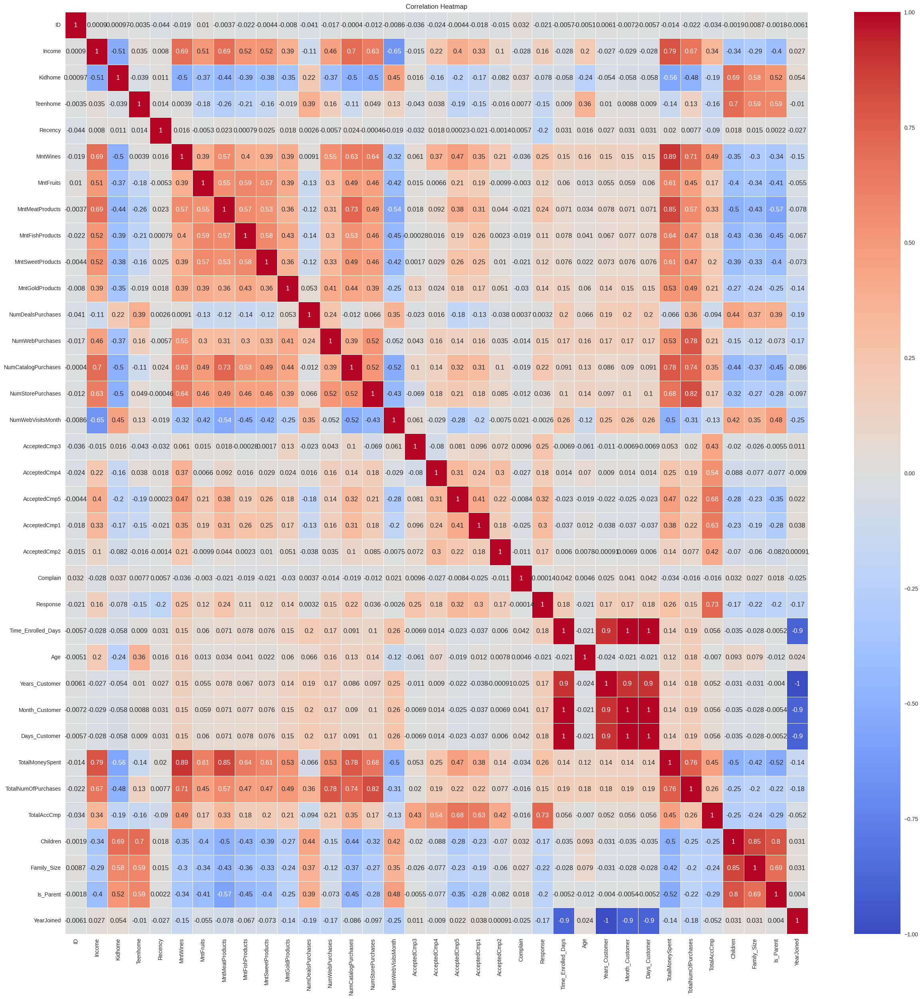

In [71]:
plt.figure(figsize=(30, 30))
sns.heatmap(data.corr() , annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

Observation

1. There are no features which are highly correlated

#Feature Transformation

Choosing the features we we will be reporting by removing unnecessary  features

In [72]:
subset = data[['Income','Kidhome','Teenhome','Age','Partner','Education']]
print('This is the data we will use for clustering:')
subset.head()

This is the data we will use for clustering:


,Income,Kidhome,Teenhome,Age,Partner,Education
0,58138.0,0,0,57,No,Graduate
1,46344.0,1,1,60,No,Graduate
2,71613.0,0,0,49,Yes,Graduate
3,26646.0,1,0,30,Yes,Graduate
4,58293.0,1,0,33,Yes,Postgraduate


In [73]:
subset.describe()

,Income,Kidhome,Teenhome,Age
count,2212.000000,2212.000000,2212.000000,2212.000000
mean,51958.810579,0.441682,0.505877,45.086347
std,21527.278844,0.536955,0.544253,11.701599
min,1730.000000,0.000000,0.000000,18.000000
25%,35233.500000,0.000000,0.000000,37.000000
50%,51371.000000,0.000000,0.000000,44.000000
75%,68487.000000,1.000000,1.000000,55.000000
max,162397.000000,2.000000,2.000000,74.000000


We aren not scaling the kidhome, teenhome cols, cause their min, max lies between 0 & 2

In [74]:
num_cols = ['Income','Age']
numeric_pipeline = make_pipeline(StandardScaler())

In [75]:
ord_cols = ['Education']
ordinal_pipeline = make_pipeline(OrdinalEncoder(categories=[['Undergraduate','Graduate','Postgraduate']]))

In [76]:
nom_cols = ['Partner']
nominal_pipeline = make_pipeline(OneHotEncoder())

Transform pipelines

In [77]:
transformer = ColumnTransformer(transformers=[('num',numeric_pipeline,num_cols),
                                           ('ordinal', ordinal_pipeline,ord_cols),
                                              ('nominal' ,nominal_pipeline,nom_cols)
                                             ])

In [78]:
transformer

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('standardscaler',
                                                  StandardScaler())]),
                                 ['Income', 'Age']),
                                ('ordinal',
                                 Pipeline(steps=[('ordinalencoder',
                                                  OrdinalEncoder(categories=[['Undergraduate',
                                                                              'Graduate',
                                                                              'Postgraduate']]))]),
                                 ['Education']),
                                ('nominal',
                                 Pipeline(steps=[('onehotencoder',
                                                  OneHotEncoder())]),
                                 ['Partner'])])

Fit the transformed data

In [79]:
transformed = transformer.fit_transform(subset)
print('Data has been Transformed')

Data has been Transformed


In [80]:
# subset = data[['Income','Age','Month_Customer','TotalMoneySpent','Children']]
# print('This is the data we will use for clustering:')
# subset.head()

# Machine Learning Model

We wii use the Elbow method to identify the optimum clusters

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

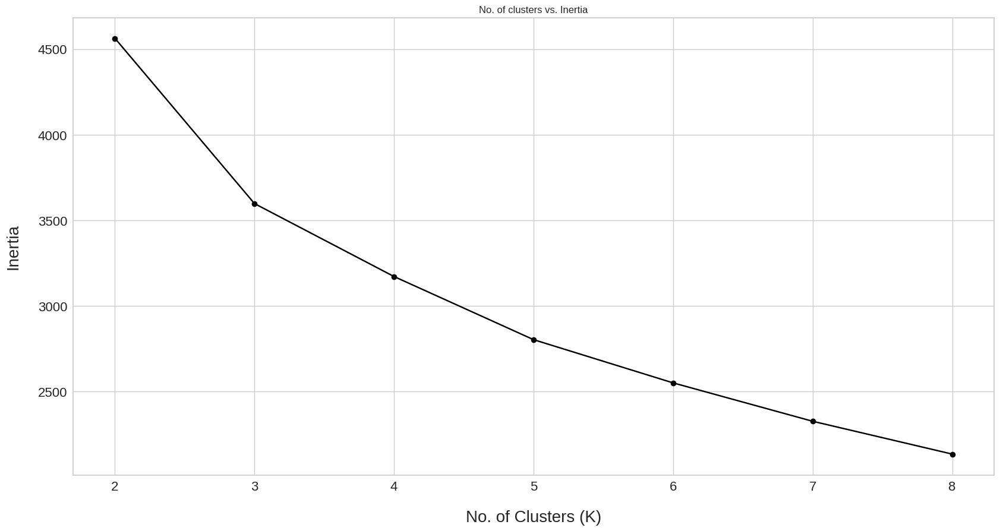

In [81]:
from sklearn.cluster import KMeans

options = range(2,9)
inertias = []

for n_clusters in options:
    model = KMeans(n_clusters, random_state=42).fit(transformed)
    inertias.append(model.inertia_)

plt.figure(figsize=(20,10))
plt.title("No. of clusters vs. Inertia")
plt.plot(options, inertias, '-o', color = 'black')
plt.xticks( fontsize=16)
plt.yticks( fontsize=16)
plt.xlabel('No. of Clusters (K)', fontsize=20, labelpad=20)
plt.ylabel('Inertia', fontsize=20, labelpad=20);

Observation


1. Based on the plot above we will group customers into 4 clusters, because the inertia value does not decrease much after 4 clusters.

Using k-means to form clusters

In [82]:
kmeans = KMeans(n_clusters=4, init='k-means++', random_state=42).fit(transformed)
subset['Clusters'] = kmeans.fit_predict(transformed) #fit the data and adding back clusters to the data in clusters column

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

<ipython-input-82-6a59e3753c42>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [83]:
subset.head()

,Income,Kidhome,Teenhome,Age,Partner,Education,Clusters
0,58138.0,0,0,57,No,Graduate,3
1,46344.0,1,1,60,No,Graduate,3
2,71613.0,0,0,49,Yes,Graduate,0
3,26646.0,1,0,30,Yes,Graduate,2
4,58293.0,1,0,33,Yes,Postgraduate,1


Count plot to see number of customers in each cluster

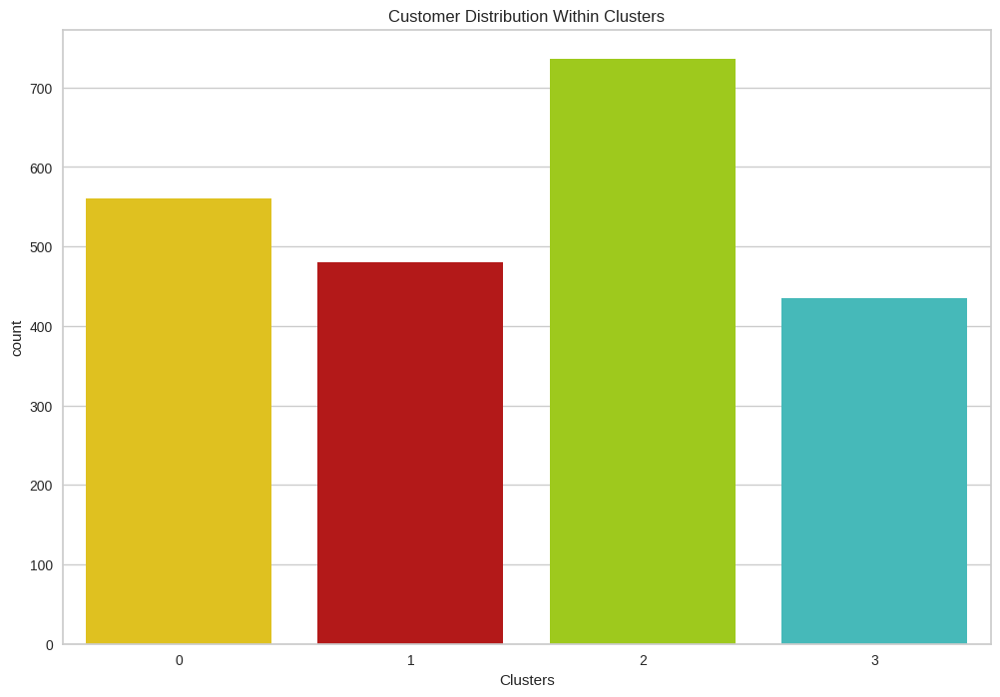

In [84]:
plt.figure(figsize=(12, 8))
sns.countplot(x='Clusters', data=subset, palette=palette)
plt.title('Customer Distribution Within Clusters')
plt.show()

Observations

1. Cluster 2 has highest number of customers
2. Cluster 3 has least number of customers

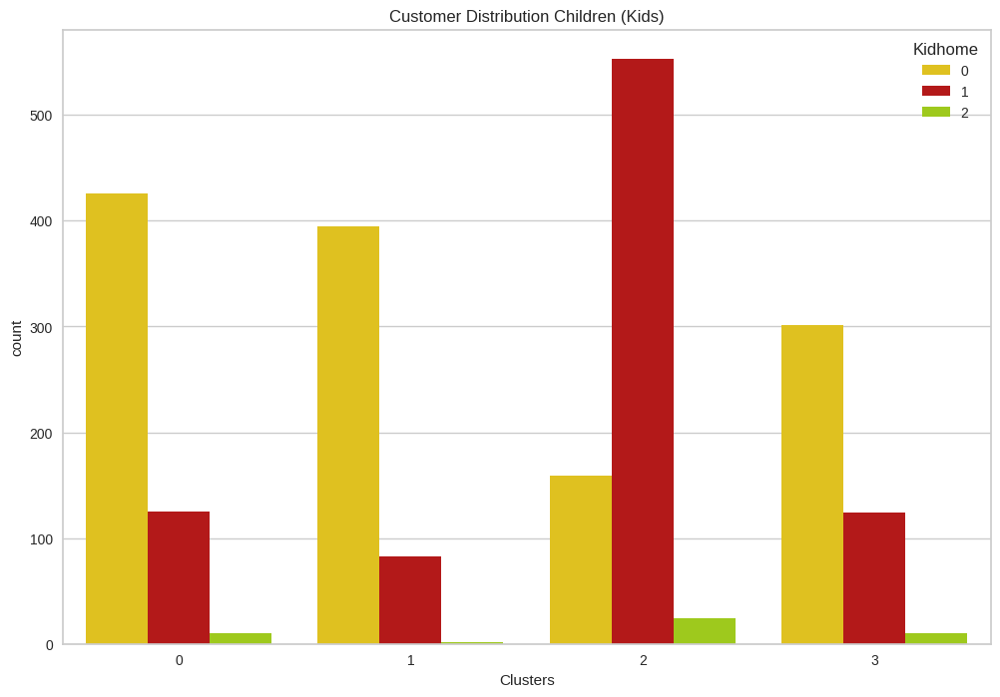

In [85]:
plt.figure(figsize=(12, 8))
sns.countplot(x='Clusters', data=subset, hue='Kidhome', palette=palette)
plt.title('Customer Distribution Children (Kids)')
plt.show()

Clusters Identification

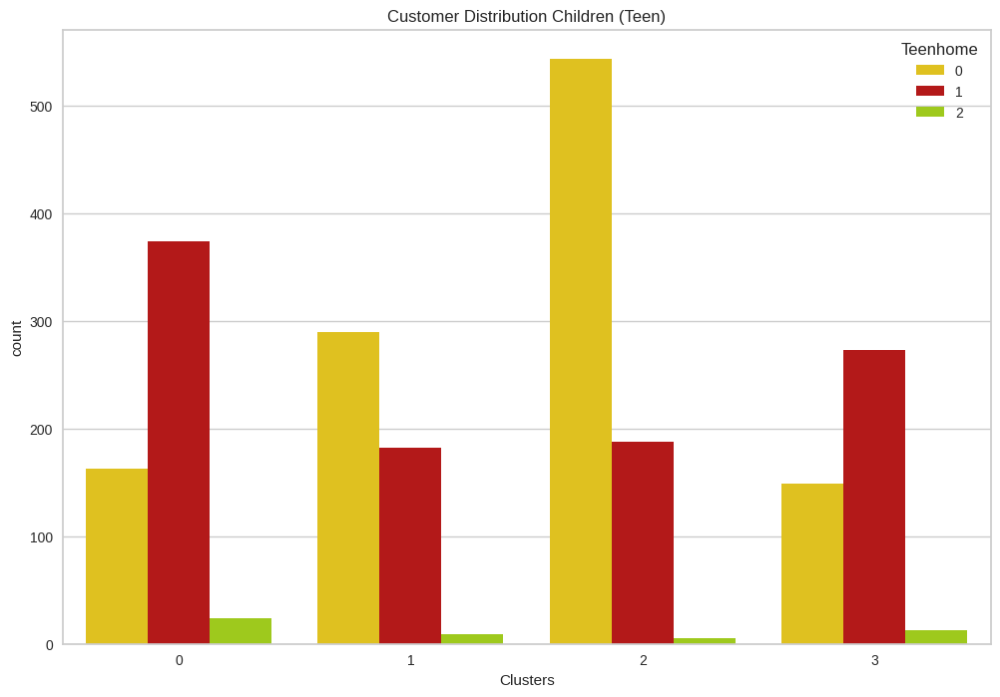

In [86]:
plt.figure(figsize=(12, 8))
sns.countplot(x='Clusters', data=subset, hue='Teenhome', palette=palette)
plt.title('Customer Distribution Children (Teen)')
plt.show()

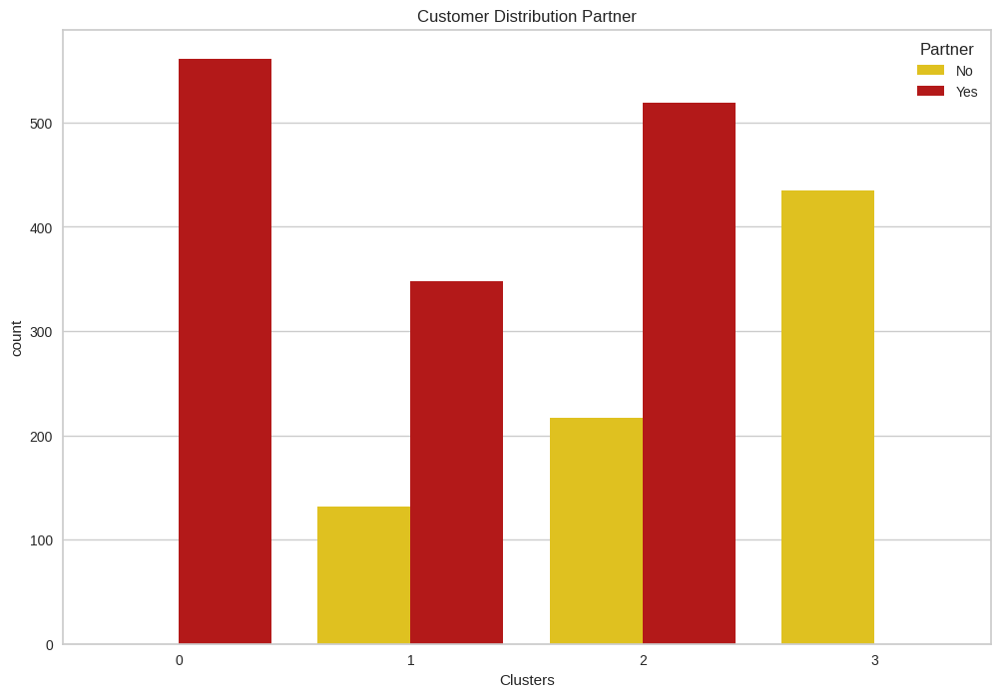

In [87]:
plt.figure(figsize=(12, 8))
sns.countplot(x='Clusters', data=subset, hue='Partner', palette=palette)
plt.title('Customer Distribution Partner')
plt.show()

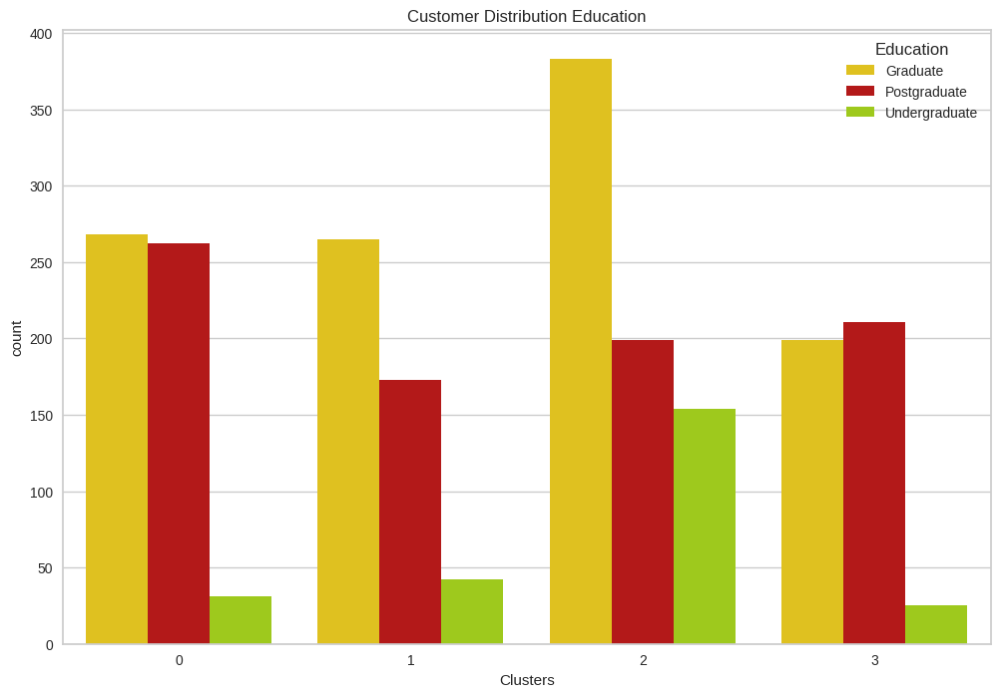

In [88]:
plt.figure(figsize=(12, 8))
sns.countplot(x='Clusters', data=subset, hue='Education', palette=palette)
plt.title('Customer Distribution Education')
plt.show()

Observation


1. Kidhome

- Cluster 0 mostly has customers with 1 kid in household
- Cluster 1 has customers with no kids in household  
- Cluster 2 also has large number of customers with no kids in household  
- Cluster 3 has customers with 0 and 1 kids in household


2. Teenhome:

- Cluster 0 consist of customers with no teen in household & few of them have 1 Teen in household
- Same goes for the cluster 1 & 3
- Cluster 2 has customers with 1 Teen in household

3. Partner

- All the customers in cluster 0 have partner
- All The customers in cluster 3 have no partner
- Cluster 1 & 2 has customers with and without partner, but most of them have partner

4. Education:

- All clusters have customers with graduate, postgraduate and undergraduate background
- All clusters have less number of customers with undergraduate background
- Cluster 2 has highest number of postgraduates and graduates

Find out the customers which have kids in different clusters

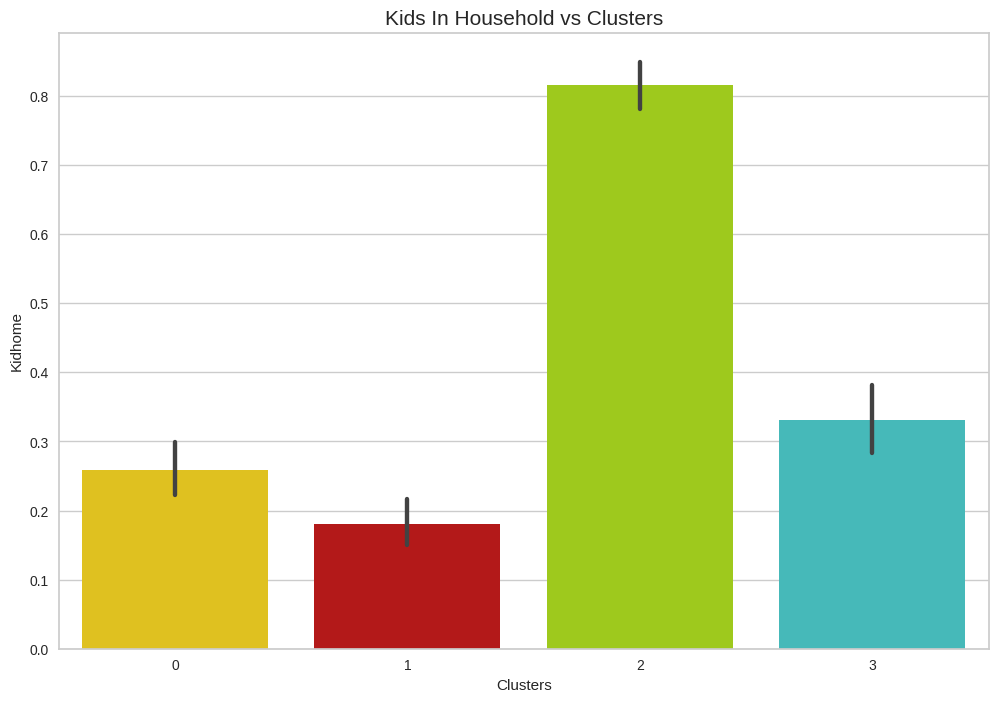

In [89]:
plt.figure(figsize=(12, 8))
sns.barplot(x=subset["Clusters"], y=subset["Kidhome"],palette=palette)
plt.title("Kids In Household vs Clusters", size=15)
plt.show()

Observation

1. Cluster 0 and 3 has the maximum number of customers with kids in household
2. Cluster 1 and 2 has the least number of customers with kids in household

Find out the customers which have kids in different clusters

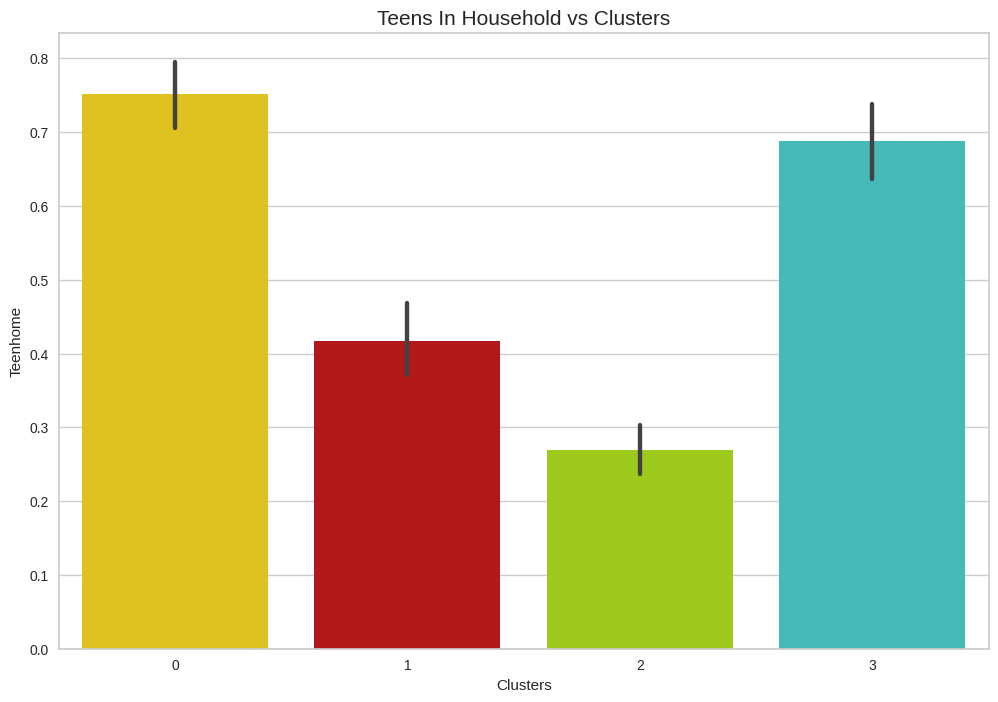

In [90]:
plt.figure(figsize=(12, 8))
sns.barplot(x=subset["Clusters"], y=subset["Teenhome"],palette=palette)
plt.title("Teens In Household vs Clusters", size=15)
plt.show()

Observation

1. Cluster 2 has maximum number of customers having Teens in household
2. Remaining Clusters also have customers with Teens in household but they are less as compared to cluster 2

Findout income of customers with in clusters

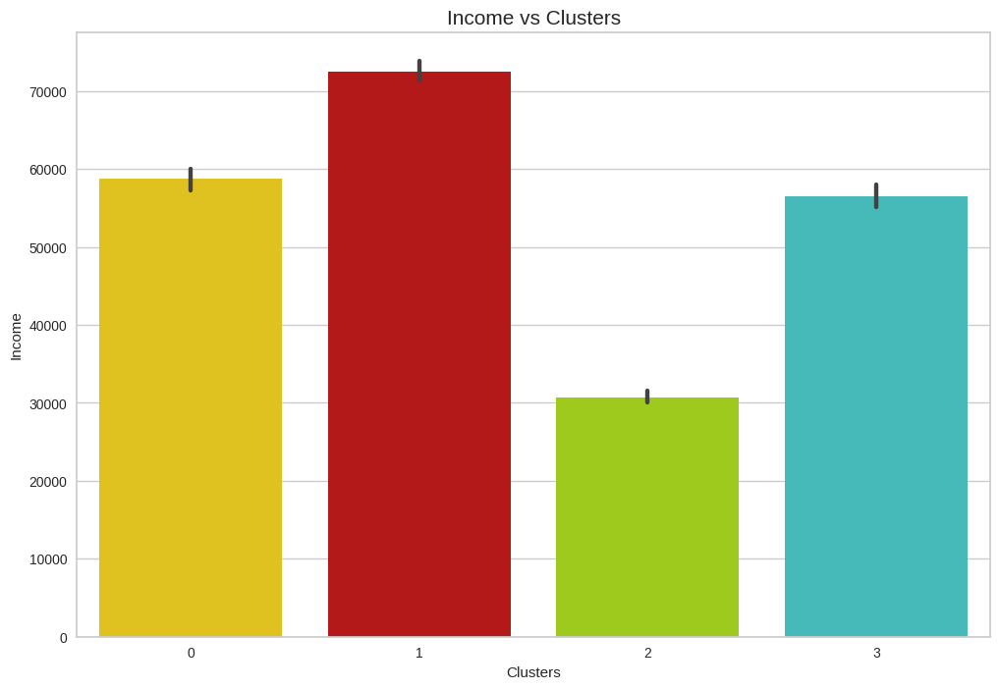

In [91]:
plt.figure(figsize=(12, 8))
sns.barplot(x=subset["Clusters"], y=subset["Income"],palette=palette)
plt.title("Income vs Clusters", size=15)
plt.show()

Observations
1. Cluster 1 has high Income followed by cluster 2 even though cluster 2 has highest number of customers and most number of post graduates & graduates as compared to cluster 1
2. Cluster 0 and 3 have least income

Contributing factor to income

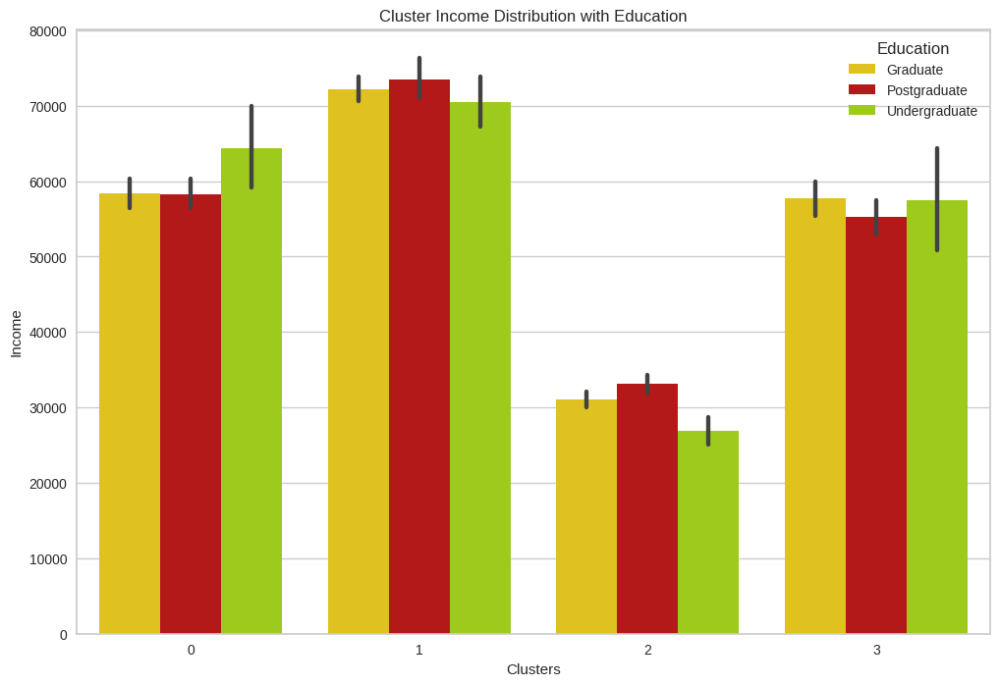

In [92]:
plt.figure(figsize=(12, 8))
sns.barplot(x='Clusters', y='Income', data=subset, hue='Education', palette=palette)
plt.title('Cluster Income Distribution with Education')
plt.show()

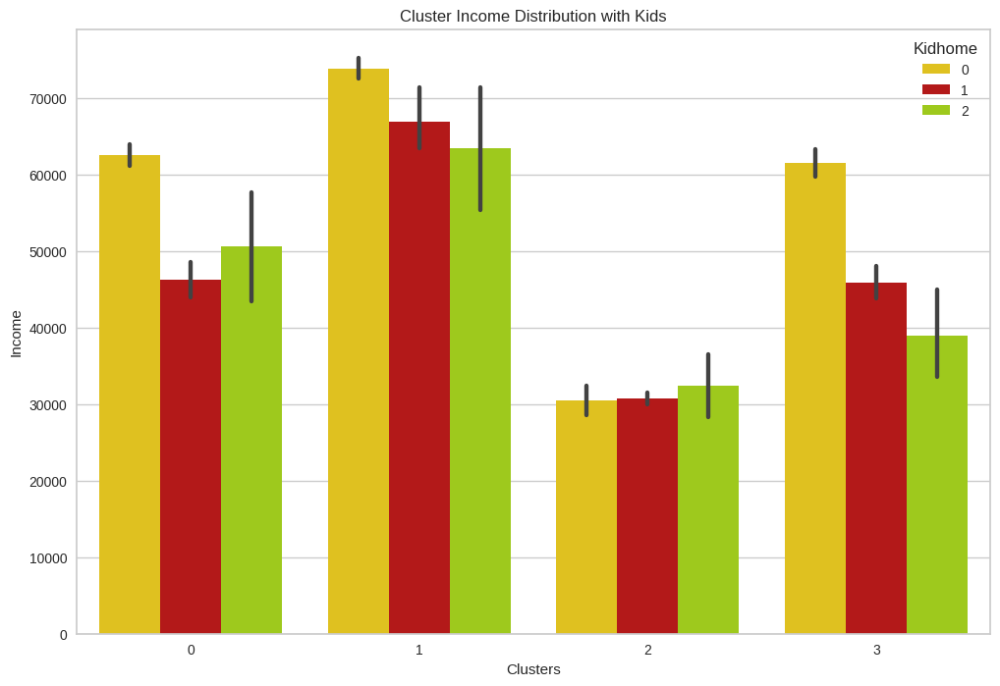

In [93]:
plt.figure(figsize=(12, 8))
sns.barplot(x='Clusters', y='Income', data=subset, hue='Kidhome', palette=palette)
plt.title('Cluster Income Distribution with Kids')
plt.show()

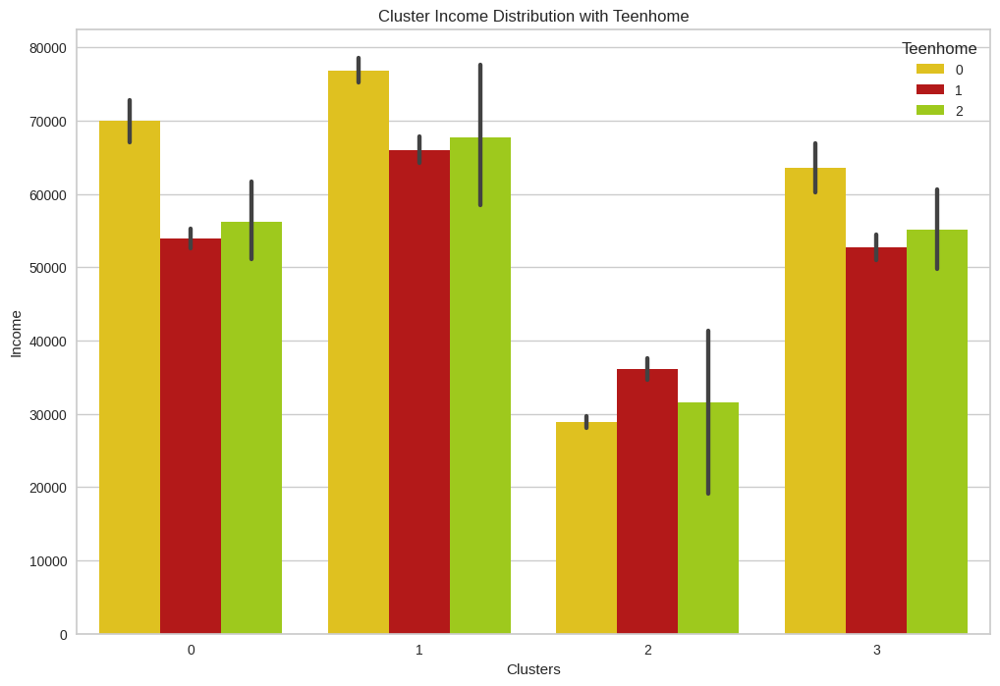

In [94]:
plt.figure(figsize=(12, 8))
sns.barplot(x='Clusters', y='Income', data=subset, hue='Teenhome', palette=palette)
plt.title('Cluster Income Distribution with Teenhome')
plt.show()

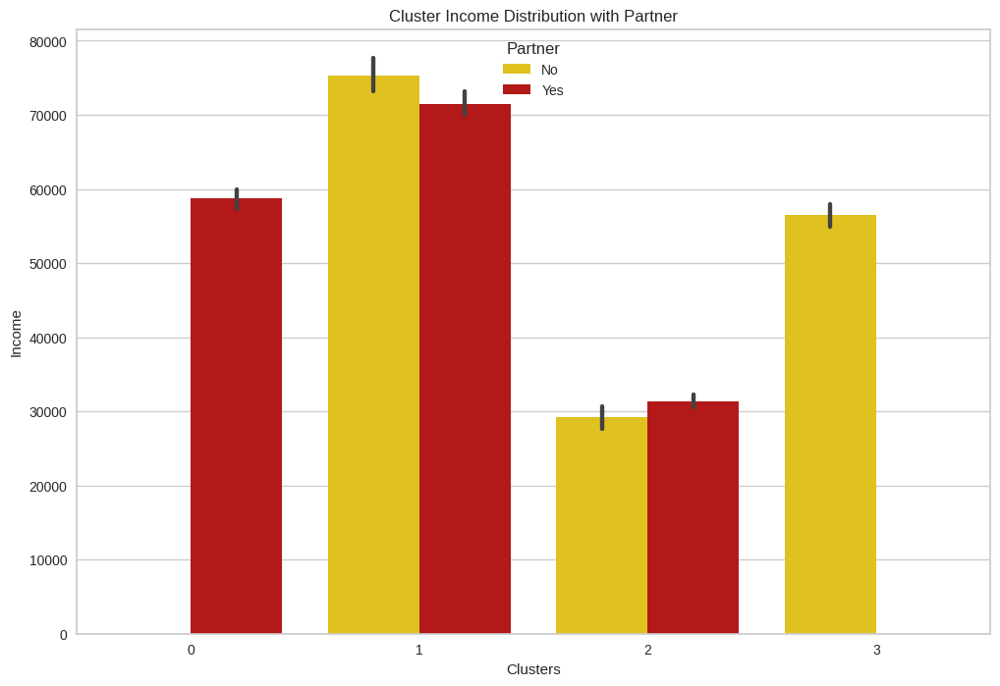

In [95]:
plt.figure(figsize=(12, 8))
sns.barplot(x='Clusters', y='Income', data=subset, hue='Partner', palette=palette)
plt.title('Cluster Income Distribution with Partner')
plt.show()

Observations

1. Interesting thing to note is that the number of customers with 2 kids or teens is very very less still their income is similar to the customers which have no kids or teens or have 1 kid & teen. So I conclude that the customers with more than 1 kid or teen in houehold has high household income 1
2. From the plots for Education and partner, I can conclude it has nothing to do with income. Infact undergraduates are earniing equal or more than graduates and postgraduates within each cluster.

Customer Profiling

1. Cluster 1

- Fewer customers but with the highest income
- No kids, few have 1 teen
- Graduates and Post Graduates
- Most of them have partners

2. Cluster 2

- Max number of customers and high income
- No kids, few have 1 or 2 teens
- High number of post graduates and graduates
- Most of them have partners

3. Cluster 0

They have the least income
- 1 kid and few have teen
- Graduates and post graudates but also has most graduates
- All have partners

4. Cluster 3
Few customers and less income
- 1 kid and few have teen
- Graduates and Post graduates
- All have no partner

# Model Building

Separate features and target column

In [96]:
x = subset.drop('Clusters', axis=1)
y = subset['Clusters']

Create train and test data

In [97]:
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.3, random_state=42)

Adding GradientBoostingClassifier to transformer pipeline

In [98]:
final_pipeline = make_pipeline(transformer, GradientBoostingClassifier())

Fit the data to new pipeline & model

In [99]:
final_pipeline.fit(x_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Income', 'Age']),
                                                 ('ordinal',
                                                  Pipeline(steps=[('ordinalencoder',
                                                                   OrdinalEncoder(categories=[['Undergraduate',
                                                                                               'Graduate',
                                                                                               'Postgraduate']]))]),
                                                  ['Education']),
                                                 ('nominal',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder())]),
                                                  ['Partner'])])),
                ('gradientboostingclassifier', GradientBoostingClassifier())])

Check the accuracy of our model

In [100]:
final_pipeline.score(x_test, y_test)

0.9864457831325302

In [101]:
joblib.dump(final_pipeline, 'customer_segmentation_cluster.pkl')

['customer_segmentation_cluster.pkl']

# Bibliography

- Mehreen Saeed, Modeling Pipeline Optimization With scikit-learn URL - https://machinelearningmastery.com/modeling-pipeline-optimization-with-scikit-learn/

- Pratik Parmar, Enable plotfly in a cell in colab URL - https://stackoverflow.com/a/54771665

- Gilbert Tanner, Building web app with streamlit and deploying wit Heroku - URL - https://gilberttanner.com/blog/deploying-your-streamlit-dashboard-with-heroku/

Note from the Author

This file was generated using The NBConvert, additional information on how to prepare articles for submission is here.

The article itself is an executable colab Markdown file that could be downloaded from Github with all the necessary artifacts.

Link to the web application - Student Dropout Predictor

Kunwar Rajdeep Singh - York University School of Continuing Studies